# Thera Bank: Credit Card Churn Prediction
_Feature Selection and Tuning_

__Joseph Reves joe.reves@gmail.com__

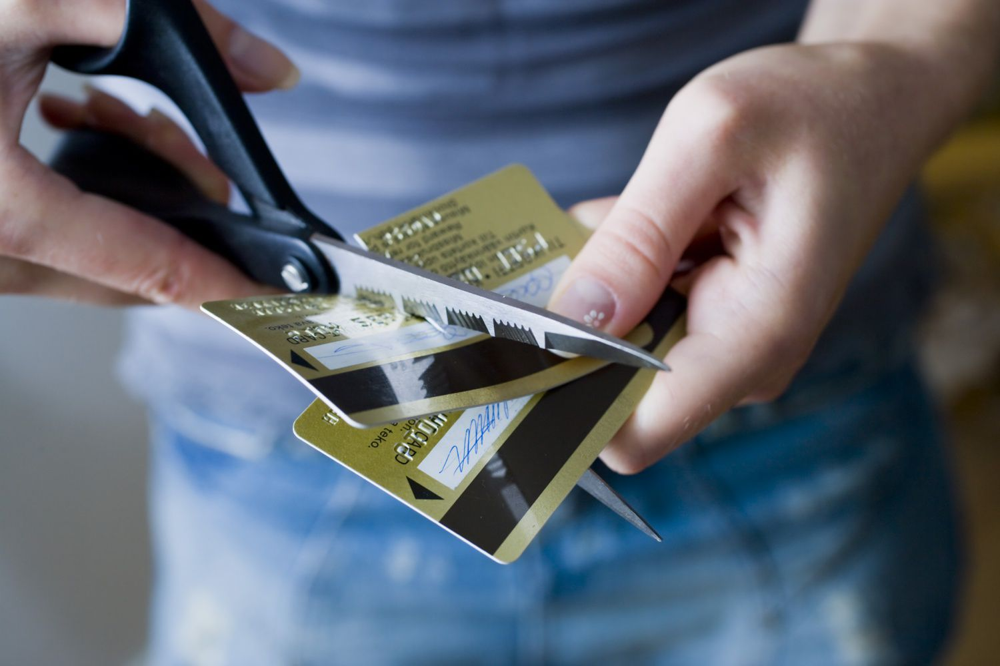

## Problem Statement

### Business Context

The Thera bank recently saw a steep decline in the number of users of their credit card, credit cards are a good source of income for banks because of different kinds of fees charged by the banks like annual fees, balance transfer fees, and cash advance fees, late payment fees, foreign transaction fees, and others. Some fees are charged to every user irrespective of usage, while others are charged under specified circumstances.

Customers’ leaving credit cards services would lead bank to loss, so the bank wants to analyze the data of customers and identify the customers who will leave their credit card services and reason for same – so that bank could improve upon those areas

You as a Data scientist at Thera bank need to come up with a classification model that will help the bank improve its services so that customers do not renounce their credit cards

### Data Description

* CLIENTNUM: Client number. Unique identifier for the customer holding the account 
* Attrition_Flag: Internal event (customer activity) variable - if the account is closed then "Attrited Customer" else "Existing Customer" 
* Customer_Age: Age in Years
* Gender: Gender of the account holder
* Dependent_count: Number of dependents 
* Education_Level: Educational Qualification of the account holder - Graduate, High School, Unknown, Uneducated, College(refers to college student), Post-Graduate, Doctorate
* Marital_Status: Marital Status of the account holder
* Income_Category: Annual Income Category of the account holder
* Card_Category: Type of Card
* Months_on_book: Period of relationship with the bank (in months)
* Total_Relationship_Count: Total no. of products held by the customer
* Months_Inactive_12_mon: No. of months inactive in the last 12 months
* Contacts_Count_12_mon: No. of Contacts in the last 12 months
* Credit_Limit: Credit Limit on the Credit Card
* Total_Revolving_Bal: Total Revolving Balance on the Credit Card
* Avg_Open_To_Buy: Open to Buy Credit Line (Average of last 12 months)
* Total_Amt_Chng_Q4_Q1: Change in Transaction Amount (Q4 over Q1)
* Total_Trans_Amt: Total Transaction Amount (Last 12 months)
* Total_Trans_Ct: Total Transaction Count (Last 12 months)
* Total_Ct_Chng_Q4_Q1: Change in Transaction Count (Q4 over Q1)
* Avg_Utilization_Ratio: Average Card Utilization Ratio

#### What Is a Revolving Balance?

- If we don't pay the balance of the revolving credit account in full every month, the unpaid portion carries over to the next month. That's called a revolving balance


##### What is the Average Open to buy?

- 'Open to Buy' means the amount left on your credit card to use. Now, this column represents the average of this value for the last 12 months.

##### What is the Average utilization Ratio?

- The Avg_Utilization_Ratio represents how much of the available credit the customer spent. This is useful for calculating credit scores.


##### Relation b/w Avg_Open_To_Buy, Credit_Limit and Avg_Utilization_Ratio:

- ( Avg_Open_To_Buy / Credit_Limit ) + Avg_Utilization_Ratio = 1

### Assignment Objectives

__Complete the EDA, answering the following key questions:__

* How is the total transaction amount distributed?
* What is the distribution of the level of education of customers?
* What is the distribution of the level of income of customers?
* How does the change in transaction amount between Q4 and Q1 (`total_ct_change_Q4_Q1`) vary by the customer's account status (`Attrition_Flag`)?
* How does the number of months a customer was inactive in the last 12 months (`Months_Inactive_12_mon`) vary by the customer's account status (`Attrition_Flag`)?
* What are the attributes that have a strong correlation with each other? 


* __Prepare the data for analysis, imputing any missing values where appropriate__


* Choose metric on interest - Build 6 models (from logistic regression, decision trees, bagging and boosting methods) Note: You can choose not to build XGBoost if you are facing issues with the installation
* Build 6 models using oversampled data (from logistic regression, decision trees, bagging and boosting methods) - You can choose not to build XGBoost if you are facing issues with the installation
* Build 6 models using undersampled data(from logistic regression, decision trees, bagging and boosting methods) - You can choose not to build XGBoost if you are facing issues with installation
* Choose models that might perform better after tuning (tune at least 3 models out of 18 built in the previous steps) - Provide proper reasoning for tuning that model - Tune the best 3 models obtained above using randomized search and metric of interest - Check the performance of 3 tuned models


* __Compare the model performance of tuned models - Choose the best model__


* __Create a final model using pipelines__


* __Provide Business recommendations and insights__

## Importing necessary libraries

In [1]:
# this will help in making the Python code more structured automatically (good coding practice)
%load_ext nb_black

# Supress and filter unecessary warning messages
import warnings

warnings.filterwarnings("ignore")

# Libraries to help with reading and manipulating data
import pandas as pd
import numpy as np

# useful utilities
import pandas_profiling

# libaries to help with data visualization
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline

# To build models for prediction

from sklearn.model_selection import train_test_split

# To impute missing values
from sklearn.impute import SimpleImputer

# To do one-hot encoding
from sklearn.preprocessing import OneHotEncoder

# To undersample and oversample the data
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# to create pipeline and make_pipeline
from sklearn.pipeline import Pipeline, make_pipeline

# to use standard scaler
from sklearn.preprocessing import StandardScaler

from sklearn import metrics
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    roc_auc_score,
    plot_confusion_matrix,
    precision_recall_curve,
    roc_curve,
    classification_report,
)
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import (
    BaggingClassifier,
    RandomForestClassifier,
    StackingClassifier,
)
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier

# To install xgboost library use - !pip install xgboost
from xgboost import XGBClassifier

<IPython.core.display.Javascript object>

## Loading the dataset

<div class="alert alert-block alert-info">
<b>Dependency:</b> Loading the "BankChurners.csv" dataset from the local directory where the notebook is stored. For this project, I'm using Anaconda on my local machine.
</div>

In [2]:
# Reading the bank shurners dataset with the read_csv function from pandas package
banking = pd.read_csv("BankChurners.csv")

<IPython.core.display.Javascript object>

In [3]:
# Let's make a copy while we explore the data, and potentially make some changes
churners = banking.copy()

<IPython.core.display.Javascript object>

## Data Overview

- Observations
- Sanity checks

In [4]:
# Quick look at a random sample of values in the data
churners.sample(10)

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
7997,714443058,Attrited Customer,43,F,4,College,Married,Less than $40K,Blue,28,...,2,4,1484.0,0,1484.0,0.200,1664,39,0.500,0.000
9406,780604083,Existing Customer,49,M,1,NaN,Single,$60K - $80K,Blue,37,...,2,2,18349.0,1209,17140.0,0.738,16422,110,0.803,0.066
8940,716609433,Attrited Customer,55,M,2,High School,Divorced,$120K +,Blue,46,...,3,2,16828.0,2517,14311.0,1.059,4939,63,0.465,0.150
7835,806914158,Attrited Customer,38,F,4,Graduate,Married,$40K - $60K,Blue,33,...,3,1,4047.0,0,4047.0,0.648,2134,34,0.478,0.000
9066,713071383,Existing Customer,54,F,1,NaN,Single,abc,Blue,36,...,3,3,3723.0,1728,1995.0,0.595,8554,99,0.678,0.464
8946,823922208,Existing Customer,49,M,3,NaN,Single,$60K - $80K,Blue,45,...,1,1,2122.0,1101,1021.0,0.711,7404,103,0.515,0.519
613,714495258,Existing Customer,26,M,0,College,Single,Less than $40K,Blue,36,...,1,3,1438.3,479,959.3,0.553,1786,37,0.370,0.333
7132,720818658,Existing Customer,50,F,1,Uneducated,Married,Less than $40K,Blue,38,...,3,3,1438.3,0,1438.3,0.679,4594,86,0.720,0.000
9681,789200208,Existing Customer,40,F,4,Uneducated,Married,abc,Blue,29,...,3,3,3326.0,2181,1145.0,0.827,13583,110,0.746,0.656
9890,711070683,Existing Customer,48,F,3,Post-Graduate,Married,$40K - $60K,Blue,37,...,1,2,6725.0,493,6232.0,0.720,13891,106,0.606,0.073


<IPython.core.display.Javascript object>

In [5]:
# What's the size and shape of the data?
print(
    "The available data includes",
    churners.shape[0],
    "rows, with",
    churners.shape[1],
    "columns of information",
)

The available data includes 10127 rows, with 21 columns of information


<IPython.core.display.Javascript object>

In [6]:
# How is the data currently typed by python?
churners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           8608 non-null   object 
 6   Marital_Status            9378 non-null   object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

<IPython.core.display.Javascript object>

In [7]:
# check for null values in the data
churners.isnull().sum()

CLIENTNUM                      0
Attrition_Flag                 0
Customer_Age                   0
Gender                         0
Dependent_count                0
Education_Level             1519
Marital_Status               749
Income_Category                0
Card_Category                  0
Months_on_book                 0
Total_Relationship_Count       0
Months_Inactive_12_mon         0
Contacts_Count_12_mon          0
Credit_Limit                   0
Total_Revolving_Bal            0
Avg_Open_To_Buy                0
Total_Amt_Chng_Q4_Q1           0
Total_Trans_Amt                0
Total_Trans_Ct                 0
Total_Ct_Chng_Q4_Q1            0
Avg_Utilization_Ratio          0
dtype: int64

<IPython.core.display.Javascript object>

* We have some null values we'll need to deal with

In [8]:
# describe the object variables
churners.describe(include="object").T

,count,unique,top,freq
Attrition_Flag,10127,2,Existing Customer,8500
Gender,10127,2,F,5358
Education_Level,8608,6,Graduate,3128
Marital_Status,9378,3,Married,4687
Income_Category,10127,6,Less than $40K,3561
Card_Category,10127,4,Blue,9436


<IPython.core.display.Javascript object>

In [9]:
# describe the numeric variables
churners.describe(exclude="object").applymap(lambda x: f"{x:0.3f}").T

,count,mean,std,min,25%,50%,75%,max
CLIENTNUM,10127.000,739177606.334,36903783.450,708082083.000,713036770.500,717926358.000,773143533.000,828343083.000
Customer_Age,10127.000,46.326,8.017,26.000,41.000,46.000,52.000,73.000
Dependent_count,10127.000,2.346,1.299,0.000,1.000,2.000,3.000,5.000
Months_on_book,10127.000,35.928,7.986,13.000,31.000,36.000,40.000,56.000
Total_Relationship_Count,10127.000,3.813,1.554,1.000,3.000,4.000,5.000,6.000
Months_Inactive_12_mon,10127.000,2.341,1.011,0.000,2.000,2.000,3.000,6.000
Contacts_Count_12_mon,10127.000,2.455,1.106,0.000,2.000,2.000,3.000,6.000
Credit_Limit,10127.000,8631.954,9088.777,1438.300,2555.000,4549.000,11067.500,34516.000
Total_Revolving_Bal,10127.000,1162.814,814.987,0.000,359.000,1276.000,1784.000,2517.000
Avg_Open_To_Buy,10127.000,7469.140,9090.685,3.000,1324.500,3474.000,9859.000,34516.000


<IPython.core.display.Javascript object>

In [10]:
# get a list of our object columns
objects = churners.select_dtypes(["object"])
object_cols = objects.columns

<IPython.core.display.Javascript object>

In [11]:
# get a list of all our columns
columns = churners.columns
print(columns)

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')


<IPython.core.display.Javascript object>

In [12]:
# check our independent variables for duplicates
churners[
    churners.duplicated(
        subset=[
            "Attrition_Flag",
            "Customer_Age",
            "Gender",
            "Dependent_count",
            "Education_Level",
            "Marital_Status",
            "Income_Category",
            "Card_Category",
            "Months_on_book",
            "Total_Relationship_Count",
            "Credit_Limit",
            "Total_Revolving_Bal",
            "Avg_Open_To_Buy",
            "Total_Amt_Chng_Q4_Q1",
            "Total_Trans_Amt",
            "Total_Trans_Ct",
            "Total_Ct_Chng_Q4_Q1",
            "Avg_Utilization_Ratio",
        ],
        keep=False,
    )
].sort_values(by=["Card_Category"])

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio


<IPython.core.display.Javascript object>

* No duplicates in our data

In [13]:
# Let's look at the unique values for our categories
for i in objects.columns:
    print("Unique values in", i, "are :")
    print(objects[i].value_counts())
    print("*" * 50)

Unique values in Attrition_Flag are :
Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64
**************************************************
Unique values in Gender are :
F    5358
M    4769
Name: Gender, dtype: int64
**************************************************
Unique values in Education_Level are :
Graduate         3128
High School      2013
Uneducated       1487
College          1013
Post-Graduate     516
Doctorate         451
Name: Education_Level, dtype: int64
**************************************************
Unique values in Marital_Status are :
Married     4687
Single      3943
Divorced     748
Name: Marital_Status, dtype: int64
**************************************************
Unique values in Income_Category are :
Less than $40K    3561
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
abc               1112
$120K +            727
Name: Income_Category, dtype: int64
**************************************************

<IPython.core.display.Javascript object>

* We're missing values in `Education_Level` and `Marital_Status`, and we're seeing this bogus 'abc' value in `Income_Category'. 
* None of these can be imputed from neighbor values, so we can treat these standalone rather than after the split.

In [14]:
# Let's populate the missing values in education with "Unknown"
churners["Education_Level"] = churners["Education_Level"].fillna("Unknown")

<IPython.core.display.Javascript object>

In [15]:
# We'll populate the missing marital status values the same way
churners["Marital_Status"] = churners["Marital_Status"].fillna("Unknown")

<IPython.core.display.Javascript object>

In [16]:
# We'll convert this bogus 'abc' income range to "Unknown"
churners.loc[
    churners[churners["Income_Category"] == "abc"].index, "Income_Category"
] = "Unknown"

<IPython.core.display.Javascript object>

* OK, now that we have our categorical values set up correctly, let's convert them to the correct type

In [17]:
# Convert our object types to categories
for i in objects.columns:
    churners[i] = churners[i].astype("category")

churners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   CLIENTNUM                 10127 non-null  int64   
 1   Attrition_Flag            10127 non-null  category
 2   Customer_Age              10127 non-null  int64   
 3   Gender                    10127 non-null  category
 4   Dependent_count           10127 non-null  int64   
 5   Education_Level           10127 non-null  category
 6   Marital_Status            10127 non-null  category
 7   Income_Category           10127 non-null  category
 8   Card_Category             10127 non-null  category
 9   Months_on_book            10127 non-null  int64   
 10  Total_Relationship_Count  10127 non-null  int64   
 11  Months_Inactive_12_mon    10127 non-null  int64   
 12  Contacts_Count_12_mon     10127 non-null  int64   
 13  Credit_Limit              10127 non-null  floa

<IPython.core.display.Javascript object>

* __The initial data preparation is complete. I'll do the Univariate and Multivariate analysis with the categories, and generate dummy variables in the subsequent step__


* __Observations__
    * We've populated missing values for `Education_Category` and `Marital_Status' to create an "Unknown" category
    * We've updated a nonsense value in `Income_Category` to reflect an "Unknown" value
    * I will likely encode the new "Unknown" categories and keep them, rather than impute values for them
    * We've checked for duplicates
    * Converting object data types to categorical has reduce memory usage substantially
    
 
__We're ready to begin the EDA__

## Exploratory Data Analysis (EDA)

#### Useful Functions

In [18]:
# Defining the function for creating boxplot and histogram
def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None, hue=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to show the density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots

    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="mediumturquoise"
    )  # boxplot will be created and a star will indicate the mean value of the column

    if (bins) and (hue):
        sns.histplot(
            data=data,
            x=feature,
            kde=kde,
            ax=ax_hist2,
            hue=hue,
            bins=bins,
            color="mediumpurple",
        )
    elif bins:
        sns.histplot(
            data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, color="mediumpurple"
        )
    elif hue:
        sns.histplot(
            data=data, x=feature, kde=kde, hue=hue, ax=ax_hist2, color="mediumpurple"
        )
    else:
        sns.histplot(
            data=data, x=feature, kde=kde, ax=ax_hist2, color="mediumpurple"
        )  # For histogram

    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram

    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

<IPython.core.display.Javascript object>

In [19]:
# function to create labeled barplots


def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=30, fontsize=12)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=data[feature].value_counts().index[:n].sort_values(),
    )

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    plt.show()  # show the plot

<IPython.core.display.Javascript object>

In [20]:
# function to plot stacked bar chart


def stacked_barplot(data, predictor, target):
    """
    Print the category counts and plot a stacked bar chart

    data: dataframe
    predictor: independent variable
    target: target variable
    """
    count = data[predictor].nunique()
    sorter = data[target].value_counts().index[-1]
    tab1 = pd.crosstab(data[predictor], data[target], margins=True).sort_values(
        by=sorter, ascending=False
    )
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(data[predictor], data[target], normalize="index").sort_values(
        by=sorter, ascending=False
    )
    tab.plot(kind="bar", stacked=True, figsize=(count + 1, 5))
    plt.legend(
        loc="lower left",
        frameon=False,
    )
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.xticks(rotation=30, fontsize=12)
    plt.show()

<IPython.core.display.Javascript object>

In [21]:
### Function to plot distributions


def distribution_plot_wrt_target(data, predictor, target):

    fig, axs = plt.subplots(2, 2, figsize=(12, 10))

    target_uniq = data[target].unique()

    axs[0, 0].set_title("Distribution of target for target=" + str(target_uniq[0]))
    sns.histplot(
        data=data[data[target] == target_uniq[0]],
        x=predictor,
        kde=True,
        ax=axs[0, 0],
        color="teal",
    )

    axs[0, 1].set_title("Distribution of target for target=" + str(target_uniq[1]))
    sns.histplot(
        data=data[data[target] == target_uniq[1]],
        x=predictor,
        kde=True,
        ax=axs[0, 1],
        color="orange",
    )

    axs[1, 0].set_title("Boxplot w.r.t target")
    sns.boxplot(data=data, x=target, y=predictor, ax=axs[1, 0], palette="gist_rainbow")

    axs[1, 1].set_title("Boxplot (without outliers) w.r.t target")
    sns.boxplot(
        data=data,
        x=target,
        y=predictor,
        ax=axs[1, 1],
        showfliers=False,
        palette="gist_rainbow",
    )

    plt.tight_layout()
    plt.show()

<IPython.core.display.Javascript object>

#### Data Profile

In [22]:
# Let's use pandas profiling from y-data to explore the larger dataset
churners.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

#### Quick Observations on Data Correlations:
* __`Customer_Age` and `Months_on_book` are correlated - older customers have been with the bank longer
* __`Credit_Limit` and `Avg_Open_To_Buy` are correlated - higher credit limit customers also have more room available to make purchases on their cards
* __`Total_Revolving_Bal` and `Avg_Utilization_Ratio` are correlated - people the use their cards frequently carry higher average balances
* __`Total_Trans_Amt` and `Total_Trans_Ct` are correlated - customers that use their card more frequently drive a larger transaction value

__No real Surprises here so far__

* __`Gender` and `Income_Categories` are correlated - we'll take a closer look
* __`Card_Category` is 93% "Blue" - our premium cards are used by only a small percentage of our customers
* __We haven't contacted almost 4% of our customers in the last 12 months
* __About one quarter of our customers carry a zero balance, and about the same number have an average utilization of zero

#### Let's look at a few interesting Univariate distributions

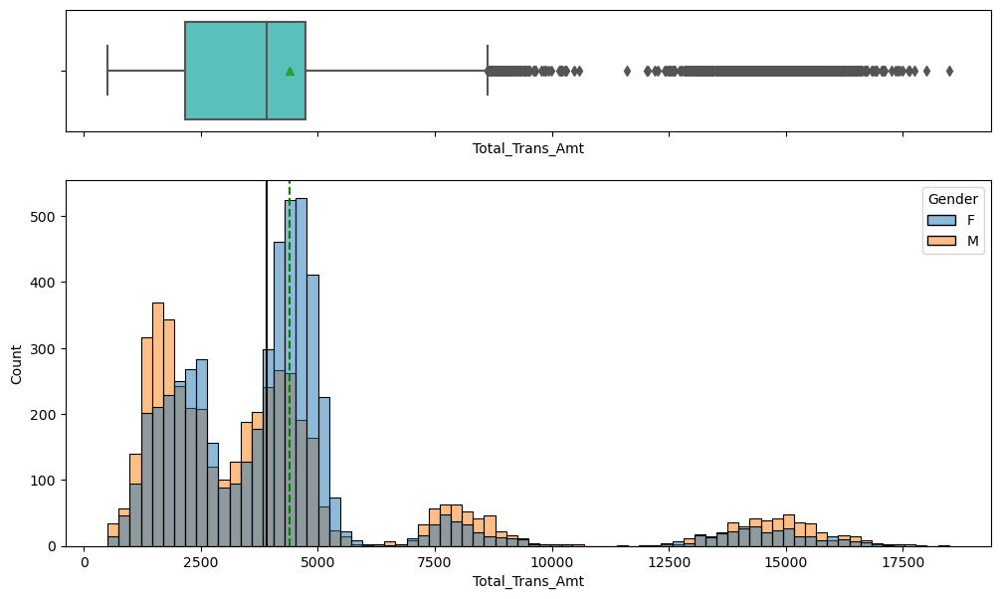

<IPython.core.display.Javascript object>

In [23]:
# Let's start with transaction amounts by gender
histogram_boxplot(churners, "Total_Trans_Amt", kde=False, hue="Gender")

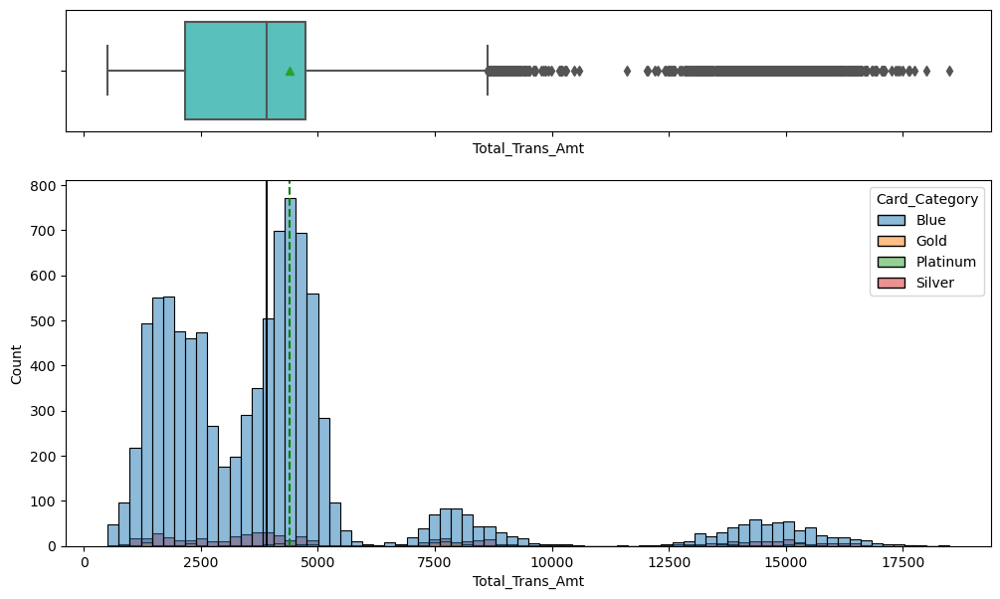

<IPython.core.display.Javascript object>

In [24]:
# Distribution by card type
histogram_boxplot(churners, "Total_Trans_Amt", kde=False, hue="Card_Category")

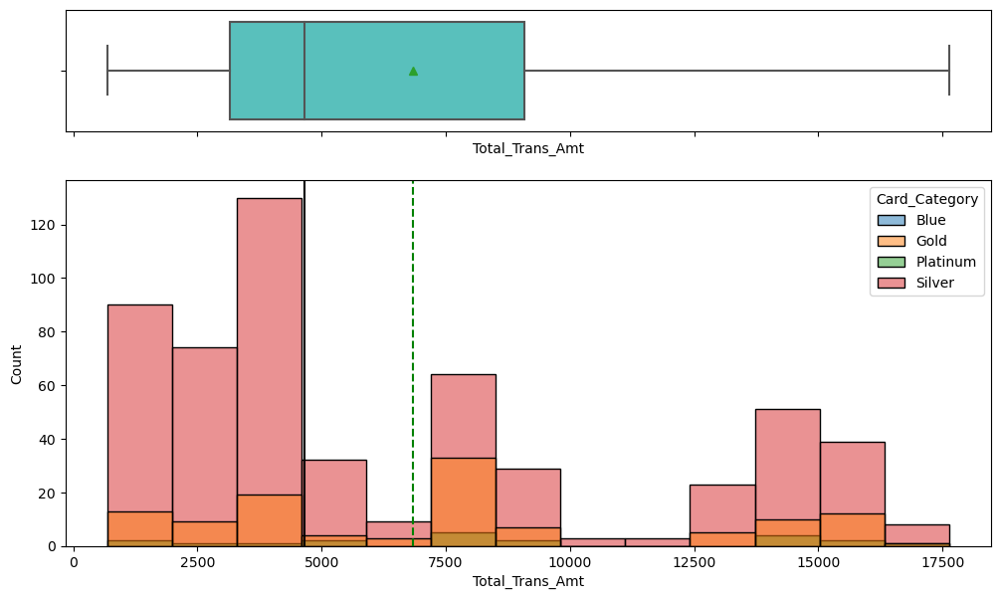

<IPython.core.display.Javascript object>

In [25]:
# All premium card customers, excluding Blue
premium_customers = churners.loc[churners["Card_Category"] != "Blue"]
histogram_boxplot(premium_customers, "Total_Trans_Amt", kde=False, hue="Card_Category")

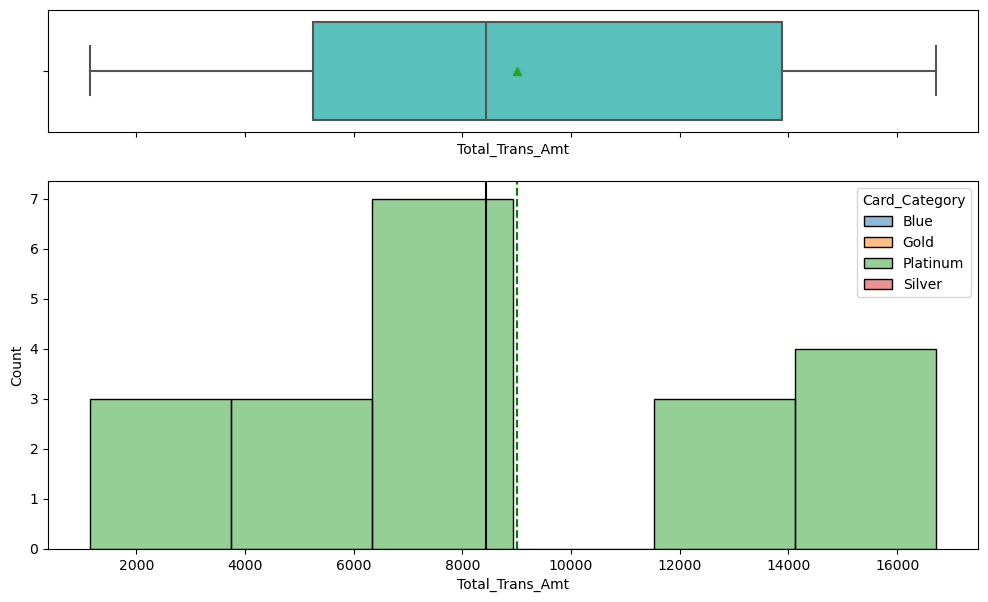

<IPython.core.display.Javascript object>

In [26]:
# Platinum card customers only. Note there are only 20 data points
platinum_customers = churners.loc[churners["Card_Category"] == "Platinum"]
histogram_boxplot(platinum_customers, "Total_Trans_Amt", kde=False, hue="Card_Category")

#### Observations:
* __There's an interesting distribution of significantly larger purchases - a long tail that skews right.
* __Most of those larger purchases are being made with our Blue card, rather than any of the premium cards.
* __Our premium cards are being used to make smaller purchases, as well
* __We can see in the breakout that Silver and Gold cards are being used across the entire range of purchases, but they have a higher mean transaction value
* __We only have 20 Platinum card customers. Their purchases skew larger, with an even higher mean value.
* __We see women mostly making purchases close to the mean value for transactions, where men are making the majority of both smaller, and much larger purchases.

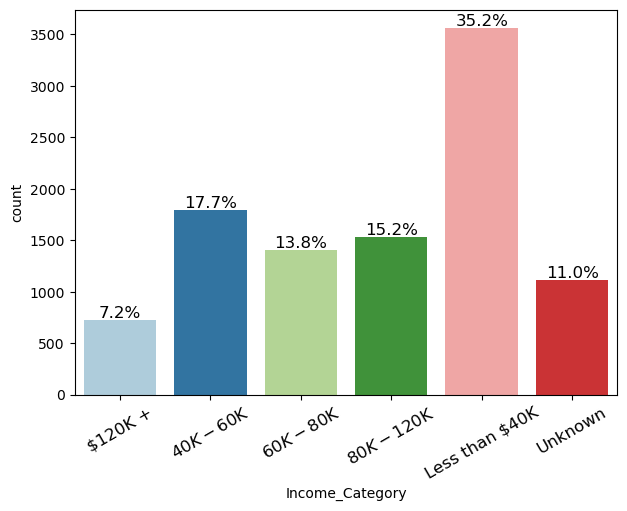

<IPython.core.display.Javascript object>

In [27]:
# Let's look at the distribution of customer incomes
labeled_barplot(churners, "Income_Category", perc=True, n=None)

Gender              F     M    All
Income_Category                   
All              5358  4769  10127
$80K - $120K        0  1535   1535
$60K - $80K         0  1402   1402
$40K - $60K      1014   776   1790
$120K +             0   727    727
Less than $40K   3284   277   3561
Unknown          1060    52   1112
------------------------------------------------------------------------------------------------------------------------


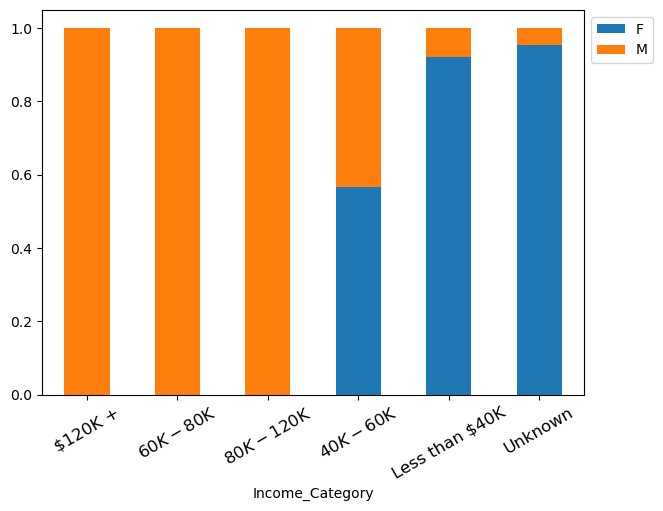

<IPython.core.display.Javascript object>

In [28]:
# And by Gender
stacked_barplot(churners, "Income_Category", "Gender")

Attrition_Flag   Attrited Customer  Existing Customer   All
Income_Category                                            
Unknown                        187                925  1112
All                            187                925  1112
------------------------------------------------------------------------------------------------------------------------


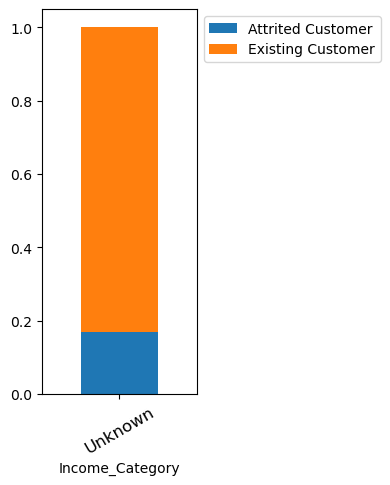

<IPython.core.display.Javascript object>

In [29]:
# Customers for which we have no income data
unknown_customers = churners.loc[churners["Income_Category"] == "Unknown"]
stacked_barplot(unknown_customers, "Income_Category", "Attrition_Flag")

#### Observations:
* __We don't have good income data for just under 10% of our active customers. That's a problem, if we're extending credit__
* __Breakdown by gender reflects a marked skew towards higher earners that are male.__
* __About 35% of our customers are earning less that \\$40K, and the majority of those are women__

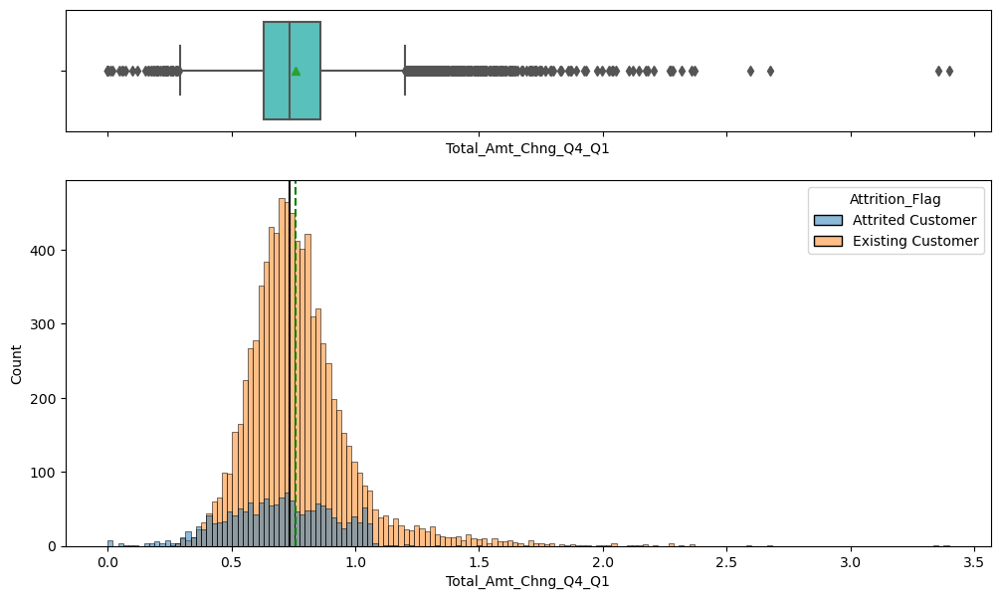

<IPython.core.display.Javascript object>

In [30]:
# Change in spending from Q1 to Q4
histogram_boxplot(churners, "Total_Amt_Chng_Q4_Q1", hue="Attrition_Flag", kde=False)

#### Observations:
* __Our Attrited customers are not showing that long tail of spending increases in Q4, which probably relates to back to school and the year-end holidays__

Attrition_Flag          Attrited Customer  Existing Customer    All
Months_Inactive_12_mon                                             
All                                  1627               8500  10127
3                                     826               3020   3846
2                                     505               2777   3282
4                                     130                305    435
1                                     100               2133   2233
5                                      32                146    178
6                                      19                105    124
0                                      15                 14     29
------------------------------------------------------------------------------------------------------------------------


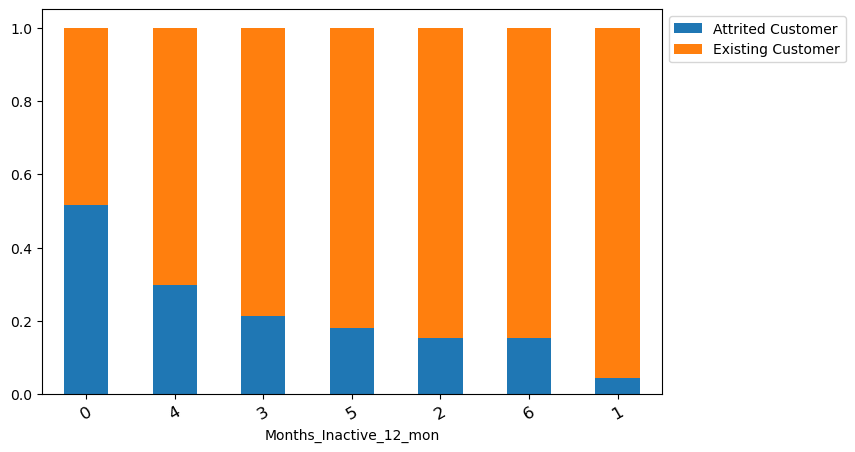

<IPython.core.display.Javascript object>

In [31]:
# what's the breakdown of inactivity over the last 12 months with customers who have churned?
stacked_barplot(churners, "Months_Inactive_12_mon", "Attrition_Flag")

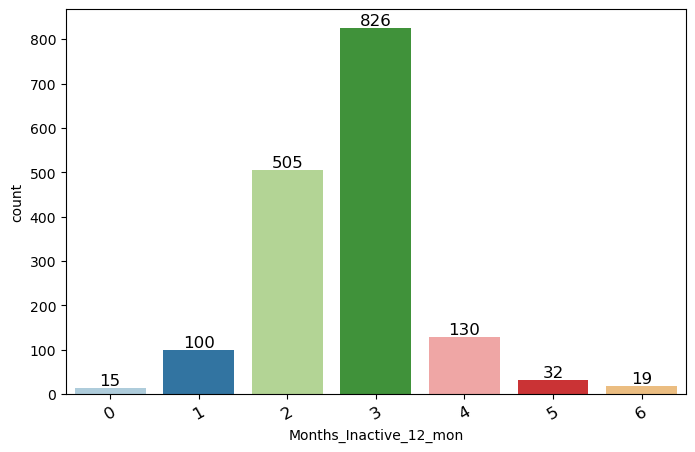

<IPython.core.display.Javascript object>

In [32]:
# How many months of inactivity do we see before customers churn?
attrited_customers = churners.loc[churners["Attrition_Flag"] == "Attrited Customer"]
labeled_barplot(attrited_customers, "Months_Inactive_12_mon", perc=False, n=None)

#### Observations:
* __We see mostly 2-3 months of inactivity before our customers attrit.  This is a trailing indicator, but we could look at two months of inactivity as a warning sign to reach out to these customers__

#### Multivariate Analysis

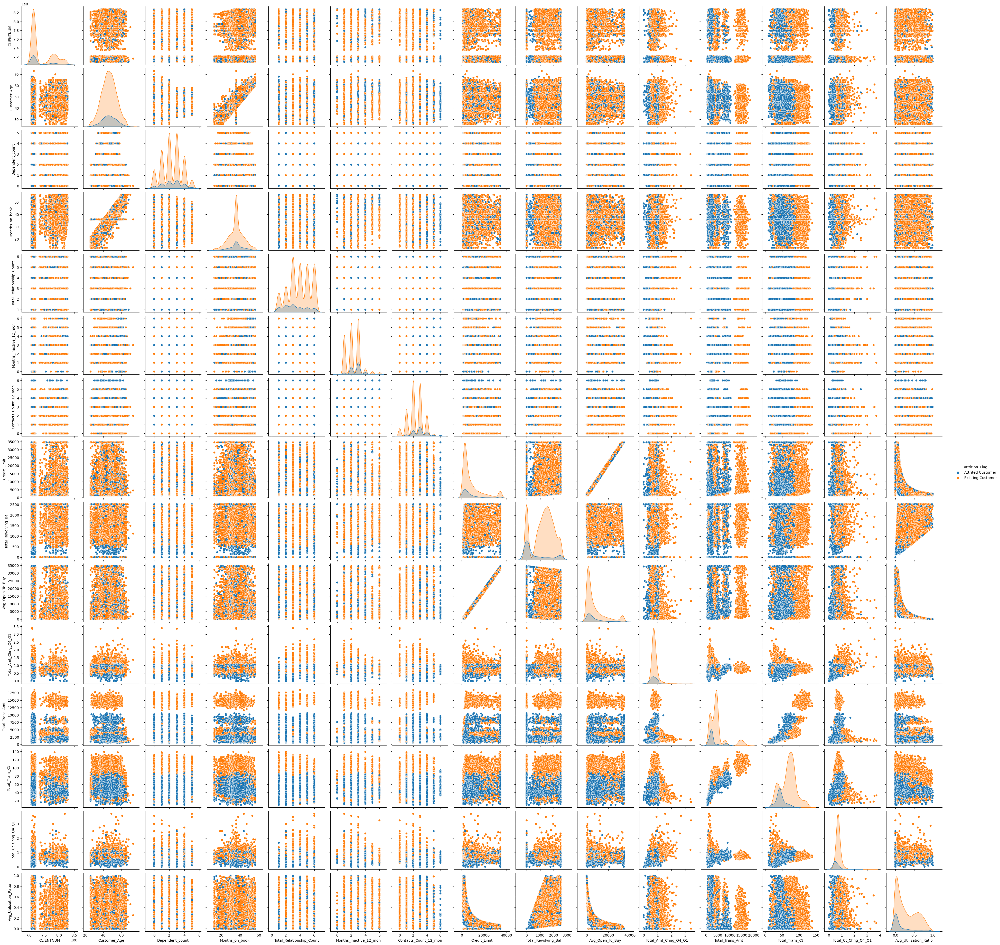

<IPython.core.display.Javascript object>

In [33]:
sns.pairplot(churners, diag_kind="kde", hue="Attrition_Flag")
plt.show()

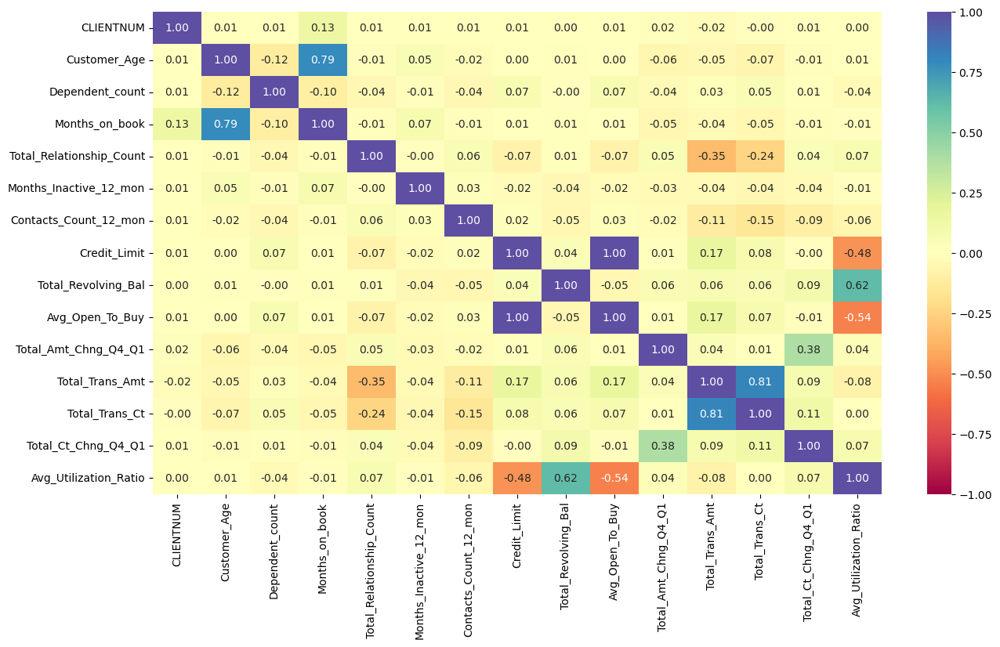

<IPython.core.display.Javascript object>

In [34]:
# Heatmap of correlations
plt.figure(figsize=(15, 8))
sns.heatmap(churners.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral")
plt.show()

## Data Pre-processing

#### Ok, it's time to encode our categories and prep our data for model construction
_Some of these we'll encode, and some we'll generate dummy variables for_

In [35]:
churners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   CLIENTNUM                 10127 non-null  int64   
 1   Attrition_Flag            10127 non-null  category
 2   Customer_Age              10127 non-null  int64   
 3   Gender                    10127 non-null  category
 4   Dependent_count           10127 non-null  int64   
 5   Education_Level           10127 non-null  category
 6   Marital_Status            10127 non-null  category
 7   Income_Category           10127 non-null  category
 8   Card_Category             10127 non-null  category
 9   Months_on_book            10127 non-null  int64   
 10  Total_Relationship_Count  10127 non-null  int64   
 11  Months_Inactive_12_mon    10127 non-null  int64   
 12  Contacts_Count_12_mon     10127 non-null  int64   
 13  Credit_Limit              10127 non-null  floa

<IPython.core.display.Javascript object>

In [36]:
# Let's start by dropping columns that won't help us predict
churners.drop("CLIENTNUM", axis=1, inplace=True)  # No value here for our model

<IPython.core.display.Javascript object>

In [37]:
# Let's just remap Attrition
churners["Attrition_Flag"].replace("Existing Customer", 0, inplace=True)
churners["Attrition_Flag"].replace("Attrited Customer", 1, inplace=True)
churners["Attrition_Flag"] = churners["Attrition_Flag"].astype("int64")

<IPython.core.display.Javascript object>

In [38]:
# Likewise, we'll remap Gender
churners["Gender"].replace("F", 0, inplace=True)
churners["Gender"].replace("M", 1, inplace=True)
churners["Gender"] = churners["Gender"].astype("int64")

<IPython.core.display.Javascript object>

__I'm choosing to encode and keep the next two variables with "Unknown" values, because I think that it's more useful to factor in the unknowns, rather than impute neighbor values for them. If I had specific numeric values, I would consider imputing those, after the split. But I think I'll get better results here with the unknown categorical value.__

In [39]:
# we'll encode Education level in rank order
churners["Education_Level"].replace("Uneducated", 0, inplace=True)
churners["Education_Level"].replace("Unknown", 0, inplace=True)
churners["Education_Level"].replace("High School", 1, inplace=True)
churners["Education_Level"].replace("College", 2, inplace=True)
churners["Education_Level"].replace("Graduate", 3, inplace=True)
churners["Education_Level"].replace("Post-Graduate", 4, inplace=True)
churners["Education_Level"].replace("Doctorate", 5, inplace=True)
churners["Education_Level"] = churners["Education_Level"].astype("int64")

<IPython.core.display.Javascript object>

In [40]:
# we'll likewise rank Income levels
churners["Income_Category"].replace("Unknown", 0, inplace=True)
churners["Income_Category"].replace("Less than $40K", 1, inplace=True)
churners["Income_Category"].replace("$40K - $60K", 2, inplace=True)
churners["Income_Category"].replace("$60K - $80K", 3, inplace=True)
churners["Income_Category"].replace("$80K - $120K", 4, inplace=True)
churners["Income_Category"].replace("$120K +", 5, inplace=True)
churners["Income_Category"] = churners["Income_Category"].astype("int64")

<IPython.core.display.Javascript object>

In [41]:
# OneHotEncoding our remaining categories
oneHotCols = [
    "Marital_Status",
    "Card_Category",
]
churners = pd.get_dummies(churners, columns=oneHotCols)

<IPython.core.display.Javascript object>

In [42]:
churners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 26 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  int64  
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  int64  
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           10127 non-null  int64  
 5   Income_Category           10127 non-null  int64  
 6   Months_on_book            10127 non-null  int64  
 7   Total_Relationship_Count  10127 non-null  int64  
 8   Months_Inactive_12_mon    10127 non-null  int64  
 9   Contacts_Count_12_mon     10127 non-null  int64  
 10  Credit_Limit              10127 non-null  float64
 11  Total_Revolving_Bal       10127 non-null  int64  
 12  Avg_Open_To_Buy           10127 non-null  float64
 13  Total_Amt_Chng_Q4_Q1      10127 non-null  float64
 14  Total_

<IPython.core.display.Javascript object>

* __We had no duplicates, no values that need to be imputed, and no other missing values__

## Model Building

### Model evaluation criterion

The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are attritions correctly predicted by the model.
- False negatives (FN) are real customer attritions where there is no detection by model. 
- False positives (FP) are attrition predictions where there is no attrition.

**Which metric to optimize?**

* We need to choose the metric which will ensure that the maximum number of customer attritions are predicted correctly by the model.
* We would want __Recall__ to be maximized as greater the Recall, the higher the chances of minimizing false negatives.
* We want to minimize false negatives because if a model predicts that no attrition will occur when there will be an attrition, we will lose customers and business.

**Let's define a function to output different metrics (including recall) on the train and test set and a function to show confusion matrix so that we do not have to use the same code repetitively while evaluating models.**

In [43]:
# defining a function to compute different metrics to check performance of a classification model built using sklearn
def model_performance_classification_sklearn(model, predictors, target):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    """

    # predicting using the independent variables
    pred = model.predict(predictors)

    acc = round(accuracy_score(target, pred), 2)  # to compute Accuracy
    recall = round(recall_score(target, pred), 2)  # to compute Recall
    precision = round(precision_score(target, pred), 2)  # to compute Precision
    f1 = round(f1_score(target, pred), 2)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {"Accuracy": acc, "Recall": recall, "Precision": precision, "F1": f1},
        index=[0],
    )

    return df_perf

<IPython.core.display.Javascript object>

In [44]:
## Function to create confusion matrix
def make_confusion_matrix(model, y_actual, labels=[1, 0]):
    """
    model : classifier to predict values of X
    y_actual : ground truth

    """
    y_predict = model.predict(X_test)
    cm = metrics.confusion_matrix(y_actual, y_predict, labels=[0, 1])
    df_cm = pd.DataFrame(
        cm,
        index=[i for i in ["Actual - No", "Actual - Yes"]],
        columns=[i for i in ["Predicted - No", "Predicted - Yes"]],
    )
    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(2, 2)
    plt.figure(figsize=(6, 4))
    sns.heatmap(df_cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

<IPython.core.display.Javascript object>

## Split the Original Data

In [45]:
# separating the independent and dependent variables
X = churners.drop(["Attrition_Flag"], axis=1)
y = churners["Attrition_Flag"]

<IPython.core.display.Javascript object>

In [46]:
# Splitting data into training, validation and test set:

# first we split data into 2 parts, temporary and test
X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=0.2, random_state=5, stratify=y
)

# then we split the temporary set into train and validation
X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.2, random_state=5, stratify=y_temp
)

print(X_train.shape, X_val.shape, X_test.shape)

(6480, 25) (1621, 25) (2026, 25)


<IPython.core.display.Javascript object>

In [47]:
# Checking class balance for whole data, train set, validation set, and test set

print("Target value ratio in y")
print(y.value_counts(1))
print("*" * 50)
print("Target value ratio in y_train")
print(y_train.value_counts(1))
print("*" * 50)
print("Target value ratio in y_val")
print(y_val.value_counts(1))
print("*" * 50)
print("Target value ratio in y_test")
print(y_test.value_counts(1))
print("*" * 50)

Target value ratio in y
0    0.83934
1    0.16066
Name: Attrition_Flag, dtype: float64
**************************************************
Target value ratio in y_train
0    0.839352
1    0.160648
Name: Attrition_Flag, dtype: float64
**************************************************
Target value ratio in y_val
0    0.838988
1    0.161012
Name: Attrition_Flag, dtype: float64
**************************************************
Target value ratio in y_test
0    0.839585
1    0.160415
Name: Attrition_Flag, dtype: float64
**************************************************


<IPython.core.display.Javascript object>

### Build Models with original data

In [48]:
# Use simple untuned default classifiers to create models with our default set of train data, and validate them
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("Decision Tree", DecisionTreeClassifier(random_state=1)))
models.append(("Random Forest", RandomForestClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("Gradient Boosting", GradientBoostingClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1)))


print("\n" "Training Performance:" "\n")
for name, model in models:
    model.fit(X_train, y_train)
    perf = model_performance_classification_sklearn(model, X_train, y_train)
    print(name, ":\n", perf.to_string(index=False, col_space=9))


print("\n" "Validation Performance:" "\n")
for name, model in models:
    model.fit(X_train, y_train)
    perf = model_performance_classification_sklearn(model, X_val, y_val)
    print(name, ":\n", perf.to_string(index=False, col_space=9))


Training Performance:

Logistic regression :
  Accuracy    Recall  Precision        F1
     0.88      0.42       0.68      0.52
Bagging :
  Accuracy    Recall  Precision        F1
      1.0      0.98        1.0      0.99
Decision Tree :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0
Random Forest :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0
AdaBoost :
  Accuracy    Recall  Precision        F1
     0.96      0.86        0.9      0.88
Gradient Boosting :
  Accuracy    Recall  Precision        F1
     0.97      0.89       0.95      0.92
XGBoost :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0

Validation Performance:

Logistic regression :
  Accuracy    Recall  Precision        F1
     0.88      0.43        0.7      0.53
Bagging :
  Accuracy    Recall  Precision        F1
     0.96       0.8       0.94      0.86
Decision Tree :
  Accuracy    Recall  Precision        F1
     0.9

<IPython.core.display.Javascript object>

#### Observations:
* __These models are completely untuned, and utilize the default parameters__
* __They are fit on the training data set, and evaluated on the validation set__


* __Decision Tree, Random Forest, Bagging, and XGBoost classifiers with default paramters all seem to overfit on the training data__
* __Logistic Regression is a non-starter, with poor recall__


* __Of these, I would identify the Gradient Boosting and AdaBoost classifiers as candidates to tune__

### Build Models with Oversampled data


#### Oversample the data

In [49]:
# Synthetic Minority Over Sampling Technique
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)

<IPython.core.display.Javascript object>

__What's the shape of the data after oversampling, compared to the original dataset__

In [50]:
print("Before OverSampling, count of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, count of label '0': {} \n".format(sum(y_train == 0)))

print("After OverSampling, count of label '1': {}".format(sum(y_train_over == 1)))
print("After OverSampling, count of label '0': {} \n".format(sum(y_train_over == 0)))

print("After OverSampling, the shape of train_X: {}".format(X_train_over.shape))
print("After OverSampling, the shape of train_y: {} \n".format(y_train_over.shape))

Before OverSampling, count of label '1': 1041
Before OverSampling, count of label '0': 5439 

After OverSampling, count of label '1': 5439
After OverSampling, count of label '0': 5439 

After OverSampling, the shape of train_X: (10878, 25)
After OverSampling, the shape of train_y: (10878,) 



<IPython.core.display.Javascript object>

#### Build default models with Oversampled Data

In [51]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("Decision Tree", DecisionTreeClassifier(random_state=1)))
models.append(("Random Forest", RandomForestClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("Gradient Boosting", GradientBoostingClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1)))


print("\n" "Training Performance:" "\n")
for name, model in models:
    model.fit(X_train_over, y_train_over)
    perf = model_performance_classification_sklearn(model, X_train_over, y_train_over)
    print(name, ":\n", perf.to_string(index=False, col_space=9))

print("\n" "Validation Performance:" "\n")
for name, model in models:
    model.fit(X_train_over, y_train_over)
    perf = model_performance_classification_sklearn(model, X_val, y_val)
    print(name, ":\n", perf.to_string(index=False, col_space=9))


Training Performance:

Logistic regression :
  Accuracy    Recall  Precision        F1
     0.82      0.82       0.82      0.82
Bagging :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0
Decision Tree :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0
Random Forest :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0
AdaBoost :
  Accuracy    Recall  Precision        F1
     0.96      0.97       0.96      0.96
Gradient Boosting :
  Accuracy    Recall  Precision        F1
     0.98      0.98       0.97      0.98
XGBoost :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0

Validation Performance:

Logistic regression :
  Accuracy    Recall  Precision        F1
     0.82       0.8       0.47      0.59
Bagging :
  Accuracy    Recall  Precision        F1
     0.95      0.86       0.85      0.85
Decision Tree :
  Accuracy    Recall  Precision        F1
     0.9

<IPython.core.display.Javascript object>

#### Observations:
* __These models are also completely untuned, and utilize the default parameters__
* __They are fit on the oversampled training data set, and evaluated on the validation set__

* __With oversampled data Decision Tree, Random Forest, Bagging, and XGBoost all overfit on the training data__
* __Logistic Regression has improved to an acceptable level, but it's not a great performer__


* __Of these, I would still identify the Gradient Boosting and AdaBoost classifiers as the best candidates to tune__

### Build Models with Undersampled data

#### Undersample the data

In [52]:
# Random undersampler for under sampling the data
rus = RandomUnderSampler(random_state=1, sampling_strategy=1)
X_train_under, y_train_under = rus.fit_resample(X_train, y_train)

<IPython.core.display.Javascript object>

__What's the shape of the data after undersampling, compared to the original dataset__

In [53]:
print("Before UnderSampling, count of label '1': {}".format(sum(y_train == 1)))
print("Before UnderSampling, count of label '0': {} \n".format(sum(y_train == 0)))

print("After UnderSampling, count of label '1': {}".format(sum(y_train_under == 1)))
print("After UnderSampling, count of label '0': {} \n".format(sum(y_train_under == 0)))

print("After UnderSampling, the shape of train_X: {}".format(X_train_under.shape))
print("After UnderSampling, the shape of train_y: {} \n".format(y_train_under.shape))

Before UnderSampling, count of label '1': 1041
Before UnderSampling, count of label '0': 5439 

After UnderSampling, count of label '1': 1041
After UnderSampling, count of label '0': 1041 

After UnderSampling, the shape of train_X: (2082, 25)
After UnderSampling, the shape of train_y: (2082,) 



<IPython.core.display.Javascript object>

#### Build default models with Undersampled Data

In [54]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("Decision Tree", DecisionTreeClassifier(random_state=1)))
models.append(("Random Forest", RandomForestClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("Gradient Boosting", GradientBoostingClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1)))


print("\n" "Training Performance:" "\n")
for name, model in models:
    model.fit(X_train_under, y_train_under)
    perf = model_performance_classification_sklearn(model, X_train_under, y_train_under)
    print(name, ":\n", perf.to_string(index=False, col_space=9))


print("\n" "Validation Performance:" "\n")
for name, model in models:
    model.fit(X_train_under, y_train_under)
    perf = model_performance_classification_sklearn(model, X_val, y_val)
    print(name, ":\n", perf.to_string(index=False, col_space=9))


Training Performance:

Logistic regression :
  Accuracy    Recall  Precision        F1
      0.8      0.79       0.81       0.8
Bagging :
  Accuracy    Recall  Precision        F1
      1.0      0.99        1.0       1.0
Decision Tree :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0
Random Forest :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0
AdaBoost :
  Accuracy    Recall  Precision        F1
     0.94      0.95       0.94      0.94
Gradient Boosting :
  Accuracy    Recall  Precision        F1
     0.98      0.98       0.97      0.98
XGBoost :
  Accuracy    Recall  Precision        F1
      1.0       1.0        1.0       1.0

Validation Performance:

Logistic regression :
  Accuracy    Recall  Precision        F1
     0.79       0.8       0.42      0.55
Bagging :
  Accuracy    Recall  Precision        F1
     0.94      0.95       0.75      0.84
Decision Tree :
  Accuracy    Recall  Precision        F1
      0.

<IPython.core.display.Javascript object>

#### Observations:
* __These models are also completely untuned, and utilize the default parameters__
* __They are fit on the undersampled training data set, and evaluated on the validation set__

* __With oversampled data Decision Tree, Random Forest, Bagging, and XGBoost all consistently overfit on the training data__
* __The spread between train and validate recall values is closing, so that's a potential third candidate. Still looks overfit.__
* __Logistic Regression has improved to a barely acceptable level, but it's still not a great performer__


* __Of these, the Gradient Boosting and AdaBoost classifiers are consistently the best candidates to tune__

### HyperparameterTuning 

#### Evaluating the candidates for further tuning

In the baseline default models, we see several that are overfitting immediately. We know from the shape of our data that we have a serious imbalance with our dependent variable, and we experiment with both oversampling the minority class, and undersampling the majority class to address the imbalance.  You can see the shape of the datasets above after each sampling operation.

We're using the oversampled or undersampled data to fit the model, then evaluating it's performance against the validation dataset. You can see the shape of the training, validation, and test data just after the split operation above.

Our most robust models for all datasets are the AdaBoost and Gradient Boosting models. Boosting is giving us some advantages in reducing bias in our model. Both oversampling and undersampling the data give us significant performance improvements for AdaBoost and Gradient Boosting.  But undersampling outperforms oversampling for this dataset.

For the third model, I'll give XGBoost a try, and see if we can address the overfitting issue.

#### Tuned AdaBoost with undersampled data

In [55]:
%%time
# defining model
abc_tuned = AdaBoostClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {
    "n_estimators": np.arange(10, 110, 10),
    "learning_rate": [0.1, 0.01, 0.2, 0.05, 1],
    "base_estimator": [
        DecisionTreeClassifier(max_depth=1, random_state=1),
        DecisionTreeClassifier(max_depth=2, random_state=1),
        DecisionTreeClassifier(max_depth=3, random_state=1),
    ],
}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(
    estimator=abc_tuned,
    param_distributions=param_grid,
    n_iter=10,
    n_jobs=-1,
    scoring=scorer,
    cv=5,
    random_state=1,
)

# Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_under, y_train_under)

# Set the clf to the best combination of parameters
abc_tuned = randomized_cv.best_estimator_
# Fit the best algorithm to the data.
abc_tuned.fit(X_train_under, y_train_under)

print(
    "Best parameters are {} with CV score={}:".format(
        randomized_cv.best_params_, randomized_cv.best_score_
    )
)

Best parameters are {'n_estimators': 60, 'learning_rate': 0.2, 'base_estimator': DecisionTreeClassifier(max_depth=2, random_state=1)} with CV score=0.9529490246595509:
Wall time: 4.32 s


<IPython.core.display.Javascript object>

In [56]:
perf = model_performance_classification_sklearn(abc_tuned, X_train_under, y_train_under)
print(
    "Tuned AdaBoost Training Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

perf = model_performance_classification_sklearn(abc_tuned, X_val, y_val)
print(
    "Tuned AdaBoost Validation Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Tuned AdaBoost Training Performance :
  Accuracy    Recall  Precision        F1
     0.97      0.97       0.96      0.97
Tuned AdaBoost Validation Performance :
  Accuracy    Recall  Precision        F1
     0.94      0.96       0.74      0.84


<IPython.core.display.Javascript object>

__Let's look at the confusion matrix for the validation dataset__

In [57]:
# Predicting the target for validation set
pred_val = abc_tuned.predict(X_val)

<IPython.core.display.Javascript object>

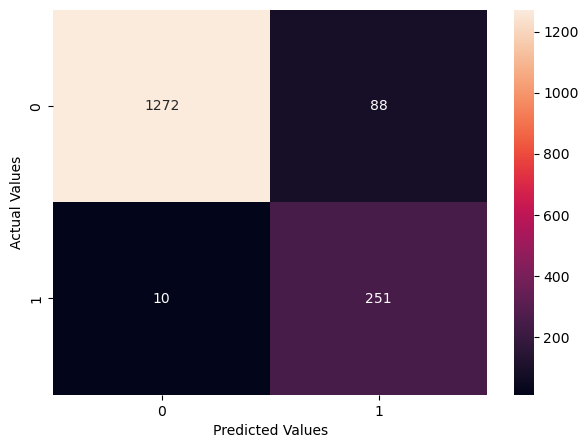

<IPython.core.display.Javascript object>

In [58]:
cm = confusion_matrix(y_val, pred_val)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

#### Tuned Gradient Boost with undersampled data

In [59]:
%%time
# defining model
gbc_tuned = GradientBoostingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {
    "init": [
        AdaBoostClassifier(random_state=1),
        DecisionTreeClassifier(random_state=1),
    ],
    "n_estimators": np.arange(75, 150, 25),
    "learning_rate": [0.1, 0.01, 0.2, 0.05, 1],
    "subsample": [0.5, 0.7, 1],
    "max_features": [0.5, 0.7, 1],
}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(
    estimator=gbc_tuned,
    param_distributions=param_grid,
    n_iter=10,
    n_jobs=-1,
    scoring=scorer,
    cv=5,
    random_state=1,
)

# Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_under, y_train_under)

# Set the clf to the best combination of parameters
gbc_tuned = randomized_cv.best_estimator_
# Fit the best algorithm to the data.
gbc_tuned.fit(X_train_under, y_train_under)

print(
    "Best parameters are {} with CV score={}:".format(
        randomized_cv.best_params_, randomized_cv.best_score_
    )
)

Best parameters are {'subsample': 1, 'n_estimators': 75, 'max_features': 0.7, 'learning_rate': 0.1, 'init': AdaBoostClassifier(random_state=1)} with CV score=0.9510075450864924:
Wall time: 1.67 s


<IPython.core.display.Javascript object>

In [60]:
perf = model_performance_classification_sklearn(gbc_tuned, X_train_under, y_train_under)
print(
    "Tuned Gradient Boost Training Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

perf = model_performance_classification_sklearn(gbc_tuned, X_val, y_val)
print(
    "Tuned Gradient Boost Validation Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Tuned Gradient Boost Training Performance :
  Accuracy    Recall  Precision        F1
     0.97      0.98       0.96      0.97
Tuned Gradient Boost Validation Performance :
  Accuracy    Recall  Precision        F1
     0.94      0.97       0.75      0.84


<IPython.core.display.Javascript object>

__Let's look at the confusion matrix for the validation dataset__

In [61]:
# Predicting the target for validation set
pred_val = gbc_tuned.predict(X_val)

<IPython.core.display.Javascript object>

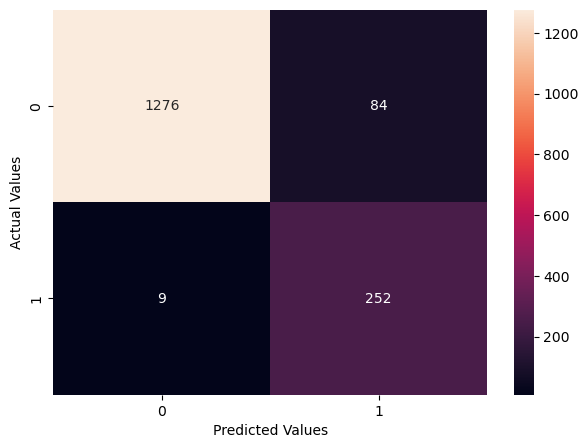

<IPython.core.display.Javascript object>

In [62]:
cm = confusion_matrix(y_val, pred_val)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

#### Tuned XGBoost with undersampled data

In [63]:
%%time
# defining model
xgb_tuned = XGBClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {
    "n_estimators": np.arange(50, 800, 50),
    "scale_pos_weight": [0, 1, 2, 5, 10],
    "learning_rate": [0.01, 0.1, 0.2, 0.05],
    "gamma": [0, 1, 3, 5],
    "subsample": [0.7, 0.8, 0.9, 1],
}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(
    estimator=xgb_tuned,
    param_distributions=param_grid,
    n_iter=10,
    n_jobs=-1,
    scoring=scorer,
    cv=5,
    random_state=1,
)

# Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_under, y_train_under)

# Set the clf to the best combination of parameters
xgb_tuned = randomized_cv.best_estimator_
# Fit the best algorithm to the data.
xgb_tuned.fit(X_train_under, y_train_under)

print(
    "Best parameters are {} with CV score={}:".format(
        randomized_cv.best_params_, randomized_cv.best_score_
    )
)

Best parameters are {'subsample': 1, 'scale_pos_weight': 5, 'n_estimators': 500, 'learning_rate': 0.1, 'gamma': 3} with CV score=0.9769506808980493:
Wall time: 3.57 s


<IPython.core.display.Javascript object>

In [64]:
perf = model_performance_classification_sklearn(xgb_tuned, X_train_under, y_train_under)
print(
    "Tuned XGBoost Training Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

perf = model_performance_classification_sklearn(xgb_tuned, X_val, y_val)
print(
    "Tuned XGBoost Validation Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Tuned XGBoost Training Performance :
  Accuracy    Recall  Precision        F1
     0.98       1.0       0.96      0.98
Tuned XGBoost Validation Performance :
  Accuracy    Recall  Precision        F1
     0.91      0.99       0.64      0.78


<IPython.core.display.Javascript object>

__Let's look at the confusion matrix for the validation dataset__

In [65]:
# Predicting the target for validation set
pred_val = xgb_tuned.predict(X_val)

<IPython.core.display.Javascript object>

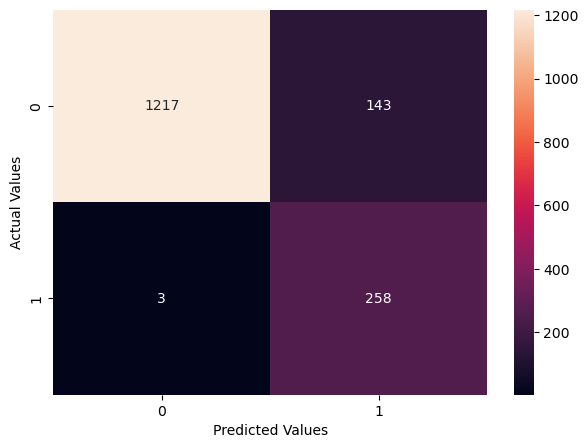

<IPython.core.display.Javascript object>

In [66]:
cm = confusion_matrix(y_val, pred_val)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

## Model Comparison and Final Model Selection

* __For our three tuned models, let's summarize their relative performance versus the respective validation datasets__

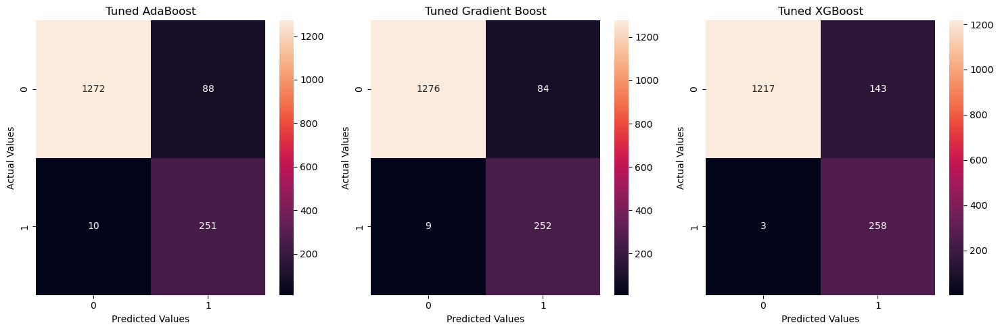

<IPython.core.display.Javascript object>

In [67]:
fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(15, 5))


cm = confusion_matrix(y_val, abc_tuned.predict(X_val))
sns.heatmap(cm, annot=True, fmt="g", ax=ax1)
ax1.set_title("Tuned AdaBoost")
ax1.set_xlabel("Predicted Values")
ax1.set_ylabel("Actual Values")

cm = confusion_matrix(y_val, gbc_tuned.predict(X_val))
sns.heatmap(cm, annot=True, fmt="g", ax=ax2)
ax2.set_title("Tuned Gradient Boost")
ax2.set_xlabel("Predicted Values")
ax2.set_ylabel("Actual Values")

cm = confusion_matrix(y_val, xgb_tuned.predict(X_val))
sns.heatmap(cm, annot=True, fmt="g", ax=ax3)
ax3.set_title("Tuned XGBoost")
ax3.set_xlabel("Predicted Values")
ax3.set_ylabel("Actual Values")

plt.tight_layout()
plt.show()

* __These models are all tuned against undersampled training data__
* __We're looking at performance relative to the validation dataset here__
* __For recall, these are the best performing tuned models, with successively better performance for each__
* __Predicted "No" and Actual "Yes" are customers we're attriting that we did not anticipate__
* __For the business, correctly predicting attriting customers give us an opportunity to reach out, understand why we may be losing them, and develop a focused action plan to retain them__

### Test set final performance

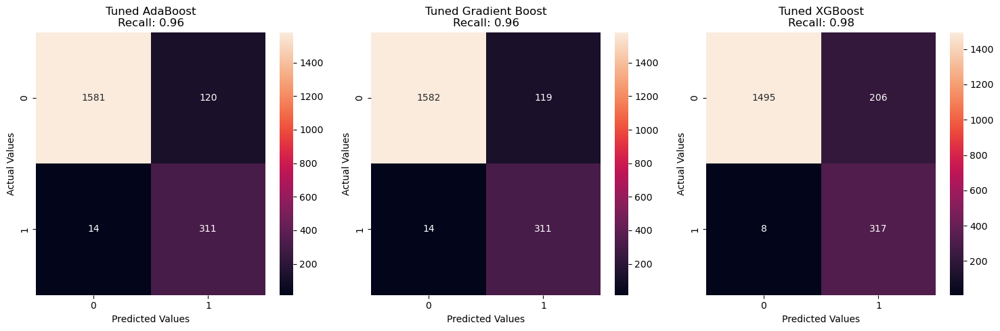

<IPython.core.display.Javascript object>

In [68]:
fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(15, 5))


cm = confusion_matrix(y_test, abc_tuned.predict(X_test))
abc_recall = round(recall_score(y_test, abc_tuned.predict(X_test)), 2)
sns.heatmap(cm, annot=True, fmt="g", ax=ax1)
ax1.set_title(f"Tuned AdaBoost\nRecall: {abc_recall}")
ax1.set_xlabel("Predicted Values")
ax1.set_ylabel("Actual Values")

cm = confusion_matrix(y_test, gbc_tuned.predict(X_test))
gbc_recall = round(recall_score(y_test, gbc_tuned.predict(X_test)), 2)
sns.heatmap(cm, annot=True, fmt="g", ax=ax2)
ax2.set_title(f"Tuned Gradient Boost\nRecall: {gbc_recall}")
ax2.set_xlabel("Predicted Values")
ax2.set_ylabel("Actual Values")

cm = confusion_matrix(y_test, xgb_tuned.predict(X_test))
xgb_recall = round(recall_score(y_test, xgb_tuned.predict(X_test)), 2)
sns.heatmap(cm, annot=True, fmt="g", ax=ax3)
ax3.set_title(f"Tuned XGBoost\nRecall: {xgb_recall}")
ax3.set_xlabel("Predicted Values")
ax3.set_ylabel("Actual Values")

plt.tight_layout()
plt.show()

#### Tuned AdaBoost Test Performance

In [69]:
perf = model_performance_classification_sklearn(abc_tuned, X_test, y_test)
print(
    "Tuned AdaBoost Test Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Tuned AdaBoost Test Performance :
  Accuracy    Recall  Precision        F1
     0.93      0.96       0.72      0.82


<IPython.core.display.Javascript object>

#### Tuned Gradient Boost Test Performance

In [70]:
perf = model_performance_classification_sklearn(gbc_tuned, X_test, y_test)
print(
    "Tuned Gradient Boost Test Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Tuned Gradient Boost Test Performance :
  Accuracy    Recall  Precision        F1
     0.93      0.96       0.72      0.82


<IPython.core.display.Javascript object>

#### Tuned XGBoost Test Performance

In [71]:
perf = model_performance_classification_sklearn(xgb_tuned, X_test, y_test)
print(
    "Tuned XGBoost Test Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Tuned XGBoost Test Performance :
  Accuracy    Recall  Precision        F1
     0.89      0.98       0.61      0.75


<IPython.core.display.Javascript object>

* __Despite a higher recall score, an XGBoost accuracy below 90% is not our best result. So, XGBoost is out__
* __Both AdaBoost and Gradient Boost produced almost identical results with high accuracy and recall values__
* __In this case AdaBoost performs slightly better in the confusion matrix. Both of these boosting algorithms are essentially identical__

### For Production, we'll use a tuned AdaBoost Model

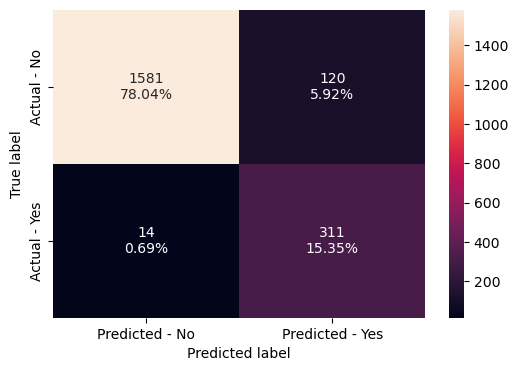

<IPython.core.display.Javascript object>

In [72]:
# With the calculated percentages, versus the test data
make_confusion_matrix(abc_tuned, y_test)

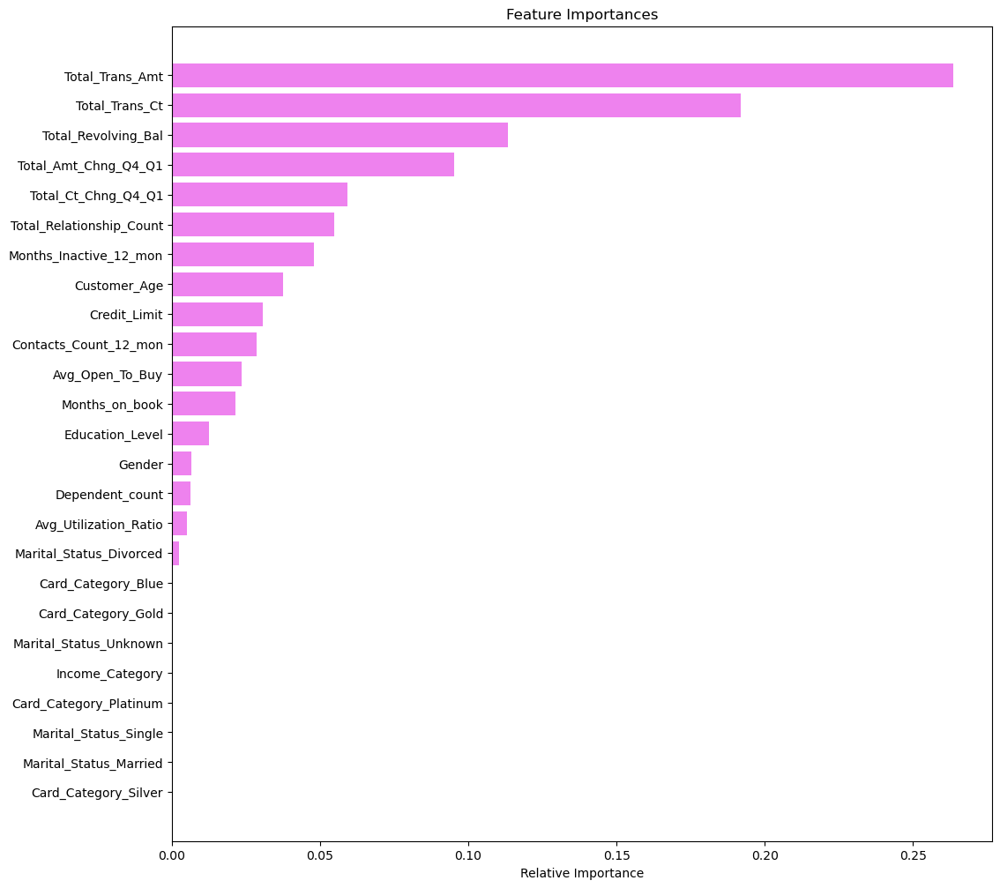

<IPython.core.display.Javascript object>

In [73]:
# Let's look at the feature importances for this model
importances = abc_tuned.feature_importances_
indices = np.argsort(importances)
feature_names = list(X.columns)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

## Pipeline to build the final model


__I'm going to make some assumptions here, for this exercise. I'll constrain the data preparation to the operations I identified for this specific data set, and assume that the values that appear for future processing will need similar preparation and transformation. Generalizing the production pipeline to handle all instances of missing data, unusual or impossible values, etc. would require a more detailed knowledge of the upstream data collection and pre-processing.__  

__So, for the purpose of this exercise, I'll organize these operations into functions I can call in my pipeline, and focus on building a working end to end pipeline for this dataset. We can get fancier in generalizing this in production.__

__As a best practice, I can see that even working in a notebook to do data exploration a solid best practice would be to encapsulate each phase within functions, to make the move to production simpler.__

#### Global variables

In [74]:
# Input dataset
dataset = "BankChurners.csv"

target_variable = "Attrition_Flag"

# random seed
random_state = 1

# Optimal parameters for the AdaBoost modeling algorithm
# These parameters come from the results of my random grid search - the best parameters
n_estimators = 60
learning_rate = 0.2

# Set up the base estimator for our adaBoost classifier
base_estimator_name = "DecisionTreeClassifier"
base_estimator_params = {"max_depth": 2, "random_state": random_state}

# Create the base estimator dynamically with the name and parameters
# This is a PIA, but required so I can pass parameters for the base estimator into Pipeline
base_estimator = globals()[base_estimator_name](**base_estimator_params)

# validation and test sizes
test_split = 0.2
val_split = 0.2

<IPython.core.display.Javascript object>

#### Load the dataset

In [75]:
def load_dataset(data):
    # Reading the bank churners dataset with the read_csv function from pandas package
    churners = pd.read_csv(dataset)

    return churners

<IPython.core.display.Javascript object>

#### Data preparation and pre-processing

In [76]:
def initial_data_prep(data):
    churners = data
    
    # Let's populate the missing values in education with "Unknown"
    churners["Education_Level"] = churners["Education_Level"].fillna("Unknown")
    # We'll populate the missing marital status values the same way
    churners["Marital_Status"] = churners["Marital_Status"].fillna("Unknown")
    # We'll convert this bogus 'abc' income range to "Unknown"
    churners.loc[
        churners[churners["Income_Category"] == "abc"].index, "Income_Category"
    ] = "Unknown"
    
    # get a list of our object columns
    objects = churners.select_dtypes(["object"])
    object_cols = objects.columns
    
    # Convert our object types to categories
    for i in objects.columns:
        churners[i] = churners[i].astype("category")
        
    return(churners)


<IPython.core.display.Javascript object>

In [77]:
def data_preprocessing(data):
    churners = data

    # Let's start by dropping columns that won't help us predict
    churners.drop("CLIENTNUM", axis=1, inplace=True)  # No value here for our model

    # Let's just remap Attrition
    churners["Attrition_Flag"].replace("Existing Customer", 0, inplace=True)
    churners["Attrition_Flag"].replace("Attrited Customer", 1, inplace=True)
    churners["Attrition_Flag"] = churners["Attrition_Flag"].astype("int64")

    # Likewise, we'll remap Gender
    churners["Gender"].replace("F", 0, inplace=True)
    churners["Gender"].replace("M", 1, inplace=True)
    churners["Gender"] = churners["Gender"].astype("int64")

    # we'll encode Education level in rank order
    churners["Education_Level"].replace("Uneducated", 0, inplace=True)
    churners["Education_Level"].replace("Unknown", 0, inplace=True)
    churners["Education_Level"].replace("High School", 1, inplace=True)
    churners["Education_Level"].replace("College", 2, inplace=True)
    churners["Education_Level"].replace("Graduate", 3, inplace=True)
    churners["Education_Level"].replace("Post-Graduate", 4, inplace=True)
    churners["Education_Level"].replace("Doctorate", 5, inplace=True)
    churners["Education_Level"] = churners["Education_Level"].astype("int64")

    # we'll likewise rank Income levels
    churners["Income_Category"].replace("Unknown", 0, inplace=True)
    churners["Income_Category"].replace("Less than $40K", 1, inplace=True)
    churners["Income_Category"].replace("$40K - $60K", 2, inplace=True)
    churners["Income_Category"].replace("$60K - $80K", 3, inplace=True)
    churners["Income_Category"].replace("$80K - $120K", 4, inplace=True)
    churners["Income_Category"].replace("$120K +", 5, inplace=True)
    churners["Income_Category"] = churners["Income_Category"].astype("int64")

    # OneHotEncoding our remaining categories
    oneHotCols = [
        "Marital_Status",
        "Card_Category",
    ]
    churners = pd.get_dummies(churners, columns=oneHotCols)

    return churners

<IPython.core.display.Javascript object>

#### Splitting data into train/test/validate

In [78]:
def split_data(data, random_state, target_variable, test_split, val_split):
    churners = data

    # separating the independent and dependent variables
    X = churners.drop([target_variable], axis=1)
    y = churners[target_variable]

    # Splitting data into training, validation and test set:

    # first we split data into 2 parts, temporary and test
    X_temp, X_test, y_temp, y_test = train_test_split(
        X, y, test_size=test_split, random_state=random_state, stratify=y
    )

    # then we split the temporary set into train and validation
    X_train, X_val, y_train, y_val = train_test_split(
        X_temp, y_temp, test_size=val_split, random_state=random_state, stratify=y_temp
    )

    return (X, y, X_train, X_val, X_test, y_train, y_val, y_test)

<IPython.core.display.Javascript object>

#### Undersampling our training data to fit our model

In [79]:
def undersample_data(X_train, y_train):

    # Random undersampler for under sampling the data
    rus = RandomUnderSampler(random_state=1, sampling_strategy=1)
    X_train_under, y_train_under = rus.fit_resample(X_train, y_train)

    return (X_train_under, y_train_under)

<IPython.core.display.Javascript object>

### Main Processing Flow

In [80]:
# Initial data load - new data
churners = load_dataset(dataset)

# Data preparation step
prepped = initial_data_prep(churners)

# Pre-processing to prepare for model construction
preprocessed = data_preprocessing(prepped)

# Data split - we'll fit on training data
X, y, X_train, X_val, X_test, y_train, y_val, y_test = split_data(
    preprocessed, random_state, target_variable, test_split, val_split
)

# Undersample our training data to address the imbalance with our target variable
X_train_under, y_train_under = undersample_data(X_train, y_train)

# Build our classification pipeline. Just one step for this application
pipe = Pipeline(
    [
        (
            "adaboost",
            AdaBoostClassifier(
                random_state=random_state,
                n_estimators=n_estimators,
                learning_rate=learning_rate,
                base_estimator=base_estimator,
            ),
        )
    ]
)

# Fit the model to our undersampled training data
pipe.fit(X_train_under, y_train_under)

Pipeline(steps=[('adaboost',
                 AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2,
                                                                          random_state=1),
                                    learning_rate=0.2, n_estimators=60,
                                    random_state=1))])

<IPython.core.display.Javascript object>

### Validate the model performance against validate, test, and full datasets

In [81]:
perf = model_performance_classification_sklearn(pipe, X_val, y_val)
print(
    "Pipeline Validate Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Pipeline Validate Performance :
  Accuracy    Recall  Precision        F1
     0.94      0.97       0.74      0.84


<IPython.core.display.Javascript object>

In [82]:
perf = model_performance_classification_sklearn(pipe, X_test, y_test)
print(
    "Pipeline Test Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Pipeline Test Performance :
  Accuracy    Recall  Precision        F1
     0.94      0.96       0.76      0.85


<IPython.core.display.Javascript object>

In [83]:
perf = model_performance_classification_sklearn(pipe, X, y)
print(
    "Pipeline Performance",
    ":\n",
    perf.to_string(index=False, col_space=9),
)

Pipeline Performance :
  Accuracy    Recall  Precision        F1
     0.94      0.97       0.74      0.84


<IPython.core.display.Javascript object>

# Business Insights and Conclusions

#### Business Observations
* __About 93% of our cardholders have "Blue" cards. Assuming we make a higher margin on premium cards with membership fees, we should consider some kind of promotion or incentive to convert some of those Blue customers to higher level products.__
* __About one quarter of our customers aren't using their cards, and aren't carrying a balance. We should consider some kind of incentive - perhaps points back with the premium card levels - to increase utilization.__
* __We have only 20 Platinum cardholders, with average transactions in the \$9000 range.  We should either promote these cards more aggressively, or consider whether we want to continue to offer this product.__
* __Our existing Blue customers are making very large purchases with their cards. If we could move those large purchases into premium cardholders, we would make a better margin on those balances.__
* __We haven't contacted about 4\% of our customers in the last 12 months. We need a tempo of customer contact that covers our entire customer base consistently.__
* __Both men and women are making very large purchases. But more higher-end purchases are made by men. We should focus our marketing for premium cards primarily to men.__
* __About 35\% of our customers are earning less than \$40K/yr, and the majority of those are women. We should have a focused campaign for the Blue card for women.__
* __We're completely missing income data for about 10% of our customers. We should make a concerted effort to update this data, and accurately reflect our customer's income. We use this to determine their credit limits; customers with higher credit limits have more room to make new purchases.__
* __Prior to customer attrition, we see about 2-3 months of inactivity.  We have this lead time to identify customers likely to drop us, and an opportunity to reach out to retain them. We should look at two months of consecutive inactivity as an indication that it's time to contact our customer, and give them an incentive to continue to use our card.__

#### Modeling
* __We'll use a tuned AdaBoost model for prediction, and we'll plan to re-tune that model every two months.__
* __We can expect about a 97% accuracy in predicting customers that will attrit.__
* __We can expect to miss about 0.7% of customers that do attrit from our prediction model.__
* __Our strongest indicators are total transaction amount, total transaction count, and the revolving balance in predicting customer attrition.__
* __We've constructed a basic production pipeline to use for predicting customer attrition__